In [77]:
import pandas as pd
import numpy as np
import gdown
import seaborn as sns
import matplotlib.pyplot as plt
# Set the style of seaborn
sns.set_theme(style="whitegrid")

from statsmodels.tsa.arima.model import ARIMA
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

from statsmodels.tsa.statespace.sarimax import SARIMAX
from datetime import datetime

from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

from pmdarima.utils import tsdisplay

from sklearn.base import BaseEstimator, TransformerMixin
import numpy as np
from sklearn.linear_model import Ridge
from sklearn.pipeline import Pipeline

%matplotlib widget

# Load price data

Table explaining each index:

| Index         | Full Name / Description                                                                 | Region/Market         | What It Represents                                   |
|---------------|----------------------------------------------------------------------------------------|-----------------------|------------------------------------------------------|
| **Brent**     | Brent Crude Oil Futures                                                                | Global (North Sea)    | Benchmark for global crude oil prices (futures)      |
| **CBOE**      | CBOE Volatility Index (VIX) or related indices from Chicago Board Options Exchange      | US/global             | Measures market volatility (often S&P 500 VIX)       |
| **Newcastle** | Newcastle Coal Futures                                                                 | Asia-Pacific          | Benchmark for thermal coal prices (futures, Australia)|
| **Henry Hub** | Henry Hub Natural Gas Spot/Futures                                                     | United States         | Main US natural gas price benchmark                  |
| **JKM**       | Japan Korea Marker (Platts JKM)                                                        | Northeast Asia        | Spot LNG price benchmark for Asia                    |
| **NBP**       | National Balancing Point                                                               | United Kingdom        | UK’s main natural gas trading benchmark              |
| **PSV**       | Punto di Scambio Virtuale                                                              | Italy                 | Italian natural gas trading hub/benchmark            |
| **TTF**       | Title Transfer Facility                                                               | Netherlands/Europe    | Main European gas trading hub and price benchmark    |

## Load

In [ ]:
# Load the CSV file
output1 = 'price_vol_temp_inven_merged_raw_data.csv'
df = pd.read_csv(output1, parse_dates=['Date'])
# Preview data
df

In [66]:
# Lowercase the column names
df.columns = df.columns.str.lower()
# Add week of day
df['week_of_day'] = df['date'].dt.dayofweek # Can only use .dt accessor with datetime-like values
# Keep only the date part (remove time)
# df['date'] = df['date'].dt.date

Here are some key dates and events during the Covid-19 pandemic that had a significant impact on natural gas prices:

| Date         | Event/Description                                                      | Impact on Natural Gas Price                |
|--------------|-----------------------------------------------------------------------|--------------------------------------------|
| 2020-01      | Covid-19 outbreak begins in China                                     | Initial demand concerns, prices start falling |
| 2020-03-11   | WHO declares Covid-19 a global pandemic                               | Global demand drops sharply, prices fall further |
| 2020-04      | Lockdowns across Europe and US, industrial activity slows             | Prices reach multi-year lows                |
| 2020-06      | Gradual reopening in Europe and US                                    | Demand and prices begin slow recovery       |
| 2020-09      | LNG demand in Asia recovers, supply tightens                          | Prices start rising                         |
| 2021-01      | Cold winter in Asia and Europe, supply chain disruptions              | Prices spike sharply                        |

Here are some key dates and events that have had a significant impact on natural gas prices in recent years, especially in Europe:

| Date         | Event/Description                                                                                  | Impact on Natural Gas Price                |
|--------------|---------------------------------------------------------------------------------------------------|--------------------------------------------|
| 2021-10      | European energy crisis begins (low storage, high demand, low Russian supply)                      | Prices surge across Europe                 |
| 2022-02-24   | Russia invades Ukraine                                                                            | Prices spike sharply due to supply fears   |
| 2022-03-07   | EU announces plans to cut Russian gas imports by two-thirds in 2022                               | Further price increases, volatility        |
| 2022-06-14   | Russia cuts Nord Stream 1 pipeline flows to 40% capacity                                          | Prices rise again                          |
| 2022-07-11   | Nord Stream 1 maintenance shutdown (10 days)                                                      | Prices volatile, fears of permanent cut    |
| 2022-07-21   | Nord Stream 1 resumes at reduced capacity (20%)                                                   | Prices remain high                         |
| 2022-08-31   | Russia halts Nord Stream 1 indefinitely                                                           | Prices spike to record highs               |
| 2022-09-26   | Nord Stream 1 & 2 pipeline explosions (sabotage)                                                  | Prices volatile, supply fears persist      |
| 2022-12-19   | EU agrees on gas price cap                                                                        | Prices stabilize somewhat                  |
| 2023-01-01   | Mild winter in Europe, high LNG imports                                                           | Prices drop from 2022 highs                |
| 2023-06-01   | European gas storage reaches record levels ahead of winter                                        | Prices stabilize, volatility decreases     |

**Sources:**  
- [IEA Gas Market Reports](https://www.iea.org/reports/gas-market-report-q4-2022)
- [Reuters Energy News](https://www.reuters.com/business/energy/)
- [Bloomberg Energy](https://www.bloomberg.com/energy)

You can use these dates as changepoints in Prophet or annotate your plots for context.

## Plots

In [ ]:
# Plot all the price columns against date
changepoints = [
    # Covid-19 impact
    '2020-01-01',  # Covid-19 outbreak begins in China
    '2020-03-11',  # WHO declares Covid-19 a global pandemic
    '2020-04-01',  # Lockdowns across Europe and US
    '2020-06-01',  # Gradual reopening in Europe and US
    '2020-09-01',  # LNG demand in Asia recovers
    '2021-01-01',  # Cold winter in Asia and Europe

    # European energy crisis and Russia-Ukraine war
    '2021-10-01',  # European energy crisis begins
    '2022-02-24',  # Russia invades Ukraine
    '2022-03-07',  # EU announces plans to cut Russian gas imports
    '2022-06-14',  # Russia cuts Nord Stream 1 pipeline flows
    '2022-07-11',  # Nord Stream 1 maintenance shutdown
    '2022-07-21',  # Nord Stream 1 resumes at reduced capacity
    '2022-08-31',  # Russia halts Nord Stream 1 indefinitely
    '2022-09-26',  # Nord Stream 1 & 2 pipeline explosions
    '2022-12-19',  # EU agrees on gas price cap
    '2023-01-01',  # Mild winter in Europe, high LNG imports
    '2023-06-01',  # European gas storage reaches record levels
]

# Standardize the price columns
df_temp = df.copy()
price_columns = [col for col in df_temp.columns if col.endswith('_price')]
for col in price_columns:
    df_temp[col] = (df_temp[col] - df_temp[col].mean()) / df_temp[col].std()

# Plotly
import plotly.express as px

price_columns = [col for col in df.columns if col.endswith('_price')]
# Line with markers with hover information showing also the week of day
fig = px.line(df_temp, x='date', y=price_columns, title='Price Trends', markers=False)

# Update the layout for better readability
# Add day of week to hover data
fig.update_traces(
    hovertemplate='%{y}<br>Date=%{x}<br>Day of Week=%{customdata}',
    customdata=df['week_of_day'].astype(str)
)
fig.update_layout(
    xaxis_title='Date',
    yaxis_title='Price',
    legend_title_text='Price Types',
    xaxis=dict(tickformat='%Y-%m-%d'),
    hoverlabel=dict(bgcolor="white", font_size=12, font_family="Arial"),
    # height=800,
    # width=1000
)
fig.show()

In [69]:
# Plotly plot of the price columns in different subplots
fig = px.line(
    df.melt(id_vars='date', value_vars=price_columns, var_name='variable', value_name='value'),
    x='date',
    y='value',
    facet_col='variable',
    facet_col_wrap=3,
    title='Price Trends by Price Type',
    labels={'date': 'Date', 'value': 'Price', 'variable': 'Price Type'},
    markers=True
)

# Add a vertical lines for significant events
for cp in changepoints:
    fig.add_vline(
        x=cp,
        line_dash="dash",
        line_color="black",
        # annotation_text=f"Changepoint: {cp}",
        # annotation_position="top left"
    )

# Update the layout for better readability
fig.update_layout(
    xaxis_title='Date',
    yaxis_title='Price',
    legend_title_text='Price Types',
    xaxis=dict(tickformat='%Y-%m-%d'),
    hoverlabel=dict(bgcolor="white", font_size=12, font_family="Arial"),
    height=700,
    width=1000
)

# Set y-axes to be independent (not shared)
fig.update_yaxes(matches=None)

fig.show()

**Data observation for the old data with the interpolation**
* Different date ranges
* KJM gap: 2013-02-14 --- 2014-07-29
* Jan-1 is not a holiday for nbp, psv, ttf?
* Weekends are dropped but only part of the holidays are dropped, e.g, Jan-01 exits for some years with missing value
* There is one Sunday with values for Brent 2025-07-06

In [ ]:
# Time Series Display for each price column
from pmdarima.utils import tsdisplay

for col in price_columns:
    print(f"Time Series Display for {col}")
    tsdisplay(df[col].dropna(), lag_max=30, title=f"Time Series Display for {col}")
    plt.show()


In [73]:
# Plotly plot the inventory data
inventory_columns = [col for col in df.columns if col.startswith('invento')]
fig = px.line(
    df.melt(id_vars='date', value_vars=inventory_columns, var_name='variable', value_name='value'),
    x='date',
    y='value',
    facet_col='variable',
    facet_col_wrap=3,
    title='Inventory Trends by Inventory Type',
    labels={'date': 'Date', 'value': 'Inventory', 'variable': 'Inventory Type'},
    markers=True
)
fig.show()


## Remove all price, volume for weekends

In [72]:
# Check the week_of_day for all prices without missing values
price_columns = [col for col in df.columns if col.endswith('_price')]
for col in price_columns:
    print(f"Week of day for {col}:")
    print(df[df[col].notna()]['week_of_day'].value_counts())
    print("\n")

# Drop all weekend rows (Saturday=5, Sunday=6)
df = df[df['week_of_day'] < 5].reset_index(drop=True)

# # Because weekends are closed for trading, we set to nan for weekend dates for the 'brent_price' and 'jkm_price'
# df.loc[(df['week_of_day'] >= 5), ['brent_price', 'jkm_price']] = np.nan

# Re-Check the week_of_day for all prices without missing values
print("\nRe-checking week_of_day after setting weekend prices to NaN:\n")
for col in price_columns:
    print(f"Week of day for {col}:")
    print(df[df[col].notna()]['week_of_day'].value_counts())
    print("\n")

Week of day for psv_price:
week_of_day
1    695
3    694
2    690
4    689
0    674
Name: count, dtype: int64


Week of day for brent_price:
week_of_day
3    859
1    857
2    856
0    853
4    839
6      1
Name: count, dtype: int64


Week of day for ttf_futures_price:
week_of_day
1    400
2    396
3    392
4    390
0    362
Name: count, dtype: int64


Week of day for pvb_price:
week_of_day
1    258
2    255
3    255
0    249
4    247
Name: count, dtype: int64


Week of day for jkm_price:
week_of_day
1    578
2    576
3    567
4    554
0    521
5      3
6      3
Name: count, dtype: int64


Week of day for nbp_price:
week_of_day
2    826
3    825
1    823
4    823
0    791
Name: count, dtype: int64


Week of day for cboe_price:
week_of_day
1    855
2    852
3    846
4    841
0    795
Name: count, dtype: int64


Week of day for coal_price:
week_of_day
3    858
2    854
1    853
4    838
0    830
Name: count, dtype: int64


Week of day for hh_price:
week_of_day
1    855
2    851
3    841


## Export the cleaned data

In [20]:
# Export the cleaned data to a new CSV file
# output2 = 'price_vol_temp_inven_merged_cleaned_data.csv'
# df.to_csv(output2, index=False)

## Identify potential data issues (data on holidays)

In [21]:
# Identify potential holidays (with fixed dates)
# Now the new merged data has all dates, so we can check for holidays
 
# Dates with missing values in price columns that repeat across years
# Convert 'date' to datetime for easier handling
df['date'] = pd.to_datetime(df['date'])

# Extract month and day for grouping
df['month_day'] = df['date'].dt.strftime('%m-%d')

# Find missing dates for each price column
holiday_candidates = {}

for col in price_columns:
    
    # Calculate the number of years in the data
    num_years = df['date'][df[col].notna()].dt.year.nunique()
    print(f"Processing column: {col} with {num_years} years of data: missing dates and counts")

    # Data range for the column
    min_date = df['date'][df[col].notna()].min()
    max_date = df['date'][df[col].notna()].max()
    mask = (df['date'] >= min_date) & (df['date'] <= max_date)

    missing_dates = df[df[col].isna() & mask]['month_day']

    # Count occurrences of each (month, day) for this column
    repeated = missing_dates.value_counts()
    display(repeated)

    # If a (month, day) is missing in >= num_years, consider as candidate for this column
    holidays = repeated[repeated >= num_years*0.5].index.tolist()
    holiday_candidates[col] = holidays

    # Print the non-missing January 1st dates
    jan_first = df[(df['month_day'] == '01-01') & (df[col].notna())][['date', col]]
    if not jan_first.empty:
        print(f"Non-missing January 1st dates")# for {col}: {jan_first.tolist()}")
        jan_first['date'] = jan_first['date'].dt.strftime('%Y-%m-%d')
        display(jan_first)

# Print potential holidays for each price column
print(f"Potential holidays for each price column:\n")
for col, holidays in holiday_candidates.items():
    if holidays:
        print(f"{col}:: {holidays}")

Processing column: psv_price with 15 years of data: missing dates and counts


month_day
12-26    8
12-25    6
12-28    4
12-27    4
01-01    4
        ..
03-07    1
03-08    1
03-09    1
03-12    1
04-21    1
Name: count, Length: 158, dtype: int64

Non-missing January 1st dates


,date,psv_price
1565,2015-01-01,25.25
1826,2016-01-01,17.68
2347,2018-01-01,20.70
2608,2019-01-01,22.50
2869,2020-01-01,12.85
3131,2021-01-01,17.15


Processing column: brent_price with 17 years of data: missing dates and counts


month_day
12-25    11
01-01    10
12-26     3
04-10     2
01-02     2
04-18     2
03-29     2
04-02     2
04-06     1
04-22     1
04-03     1
03-25     1
04-14     1
03-30     1
04-19     1
04-15     1
04-07     1
Name: count, dtype: int64

Non-missing January 1st dates


,date,brent_price
1304,2014-01-01,110.92


Processing column: ttf_futures_price with 9 years of data: missing dates and counts


month_day
01-01    6
12-25    6
07-04    5
11-23    2
06-19    2
02-17    2
01-20    2
11-28    2
05-27    2
09-02    2
01-15    2
02-19    2
05-29    1
12-26    1
02-21    1
04-15    1
05-30    1
06-20    1
09-05    1
11-24    1
01-02    1
04-07    1
01-16    1
04-18    1
03-29    1
12-24    1
09-04    1
02-20    1
01-17    1
02-15    1
11-25    1
04-10    1
03-30    1
05-28    1
09-03    1
11-22    1
01-21    1
02-18    1
04-19    1
05-25    1
09-06    1
07-03    1
09-07    1
11-26    1
01-18    1
04-02    1
05-31    1
07-05    1
05-26    1
Name: count, dtype: int64

Processing column: pvb_price with 6 years of data: missing dates and counts


month_day
12-25    3
01-01    3
05-01    3
12-26    3
04-18    2
04-01    1
03-29    1
04-10    1
04-07    1
02-17    1
11-01    1
10-18    1
10-12    1
04-15    1
03-09    1
03-07    1
03-03    1
02-25    1
02-24    1
01-21    1
01-14    1
01-12    1
01-07    1
01-06    1
12-24    1
12-23    1
12-17    1
11-15    1
05-03    1
04-05    1
04-02    1
04-21    1
Name: count, dtype: int64

Processing column: jkm_price with 14 years of data: missing dates and counts


month_day
12-25    10
01-01    10
07-04     9
06-19     5
04-15     5
         ..
09-18     1
09-19     1
09-20     1
09-23     1
03-30     1
Name: count, Length: 304, dtype: int64

Processing column: nbp_price with 17 years of data: missing dates and counts


month_day
12-26    8
12-25    5
05-27    3
05-06    2
12-28    2
08-26    2
04-18    2
12-27    2
04-01    2
03-29    2
01-01    2
08-28    1
05-08    1
05-01    1
04-21    1
04-10    1
04-07    1
05-05    1
01-02    1
06-03    1
05-02    1
05-29    1
04-05    1
01-03    1
05-31    1
05-03    1
05-07    1
05-25    1
04-13    1
04-22    1
08-27    1
05-28    1
08-29    1
06-05    1
06-04    1
05-26    1
Name: count, dtype: int64

Non-missing January 1st dates


,date,nbp_price
261,2010-01-01,35.50
1304,2014-01-01,66.13
1565,2015-01-01,48.55
1826,2016-01-01,32.77
2347,2018-01-01,52.65
2608,2019-01-01,58.25
2869,2020-01-01,27.00
3131,2021-01-01,57.40
4174,2025-01-01,122.00


Processing column: cboe_price with 17 years of data: missing dates and counts


month_day
01-01    11
12-25     9
07-04     8
01-02     3
05-25     3
09-07     3
01-18     3
02-15     3
01-21     2
01-16     2
02-20     2
02-16     2
05-28     2
09-03     2
11-22     2
01-19     2
02-18     2
05-27     2
12-26     2
11-28     2
01-20     2
02-17     2
04-18     2
09-02     2
09-05     2
11-24     2
07-05     2
04-10     2
07-03     2
11-26     2
05-31     2
09-06     2
01-17     2
02-21     2
05-30     2
05-29     1
01-15     1
02-19     1
11-27     1
04-14     1
09-04     1
03-30     1
11-23     1
03-25     1
04-03     1
04-06     1
09-01     1
05-26     1
03-29     1
10-30     1
10-29     1
04-22     1
12-24     1
11-25     1
04-02     1
12-05     1
Name: count, dtype: int64

Processing column: coal_price with 17 years of data: missing dates and counts


month_day
01-01    11
12-25    11
12-26     6
01-02     3
04-10     2
04-18     2
04-06     2
03-29     2
04-02     2
12-27     2
04-21     1
04-15     1
04-19     1
03-30     1
04-14     1
03-25     1
08-31     1
05-25     1
05-04     1
04-03     1
11-04     1
08-25     1
05-26     1
05-05     1
04-25     1
05-02     1
08-26     1
05-27     1
04-01     1
08-30     1
08-27     1
06-05     1
06-04     1
05-07     1
04-09     1
12-28     1
04-22     1
08-29     1
05-30     1
04-07     1
Name: count, dtype: int64

Processing column: hh_price with 17 years of data: missing dates and counts


month_day
12-25    10
01-01    10
07-04     9
07-05     3
09-02     3
         ..
03-30     1
04-03     1
09-01     1
04-22     1
10-14     1
Name: count, Length: 62, dtype: int64

Non-missing January 1st dates


,date,hh_price
1826,2016-01-01,2.28


Processing column: ttf_price with 17 years of data: missing dates and counts


month_day
12-26    8
12-25    5
01-01    3
04-18    2
03-29    2
04-01    2
12-27    2
05-27    2
12-28    2
04-10    1
01-02    1
04-07    1
11-01    1
05-01    1
05-08    1
06-03    1
08-28    1
08-26    1
04-21    1
05-29    1
08-30    1
05-02    1
01-03    1
04-05    1
05-25    1
04-13    1
04-22    1
08-27    1
05-28    1
05-06    1
04-06    1
05-26    1
Name: count, dtype: int64

Non-missing January 1st dates


,date,ttf_price
0,2009-01-01,21.00
261,2010-01-01,15.00
1304,2014-01-01,26.60
1565,2015-01-01,20.70
1826,2016-01-01,14.62
2347,2018-01-01,19.55
2608,2019-01-01,21.05
2869,2020-01-01,11.60
3131,2021-01-01,18.80


Potential holidays for each price column:

psv_price:: ['12-26']
brent_price:: ['12-25', '01-01']
ttf_futures_price:: ['01-01', '12-25', '07-04']
pvb_price:: ['12-25', '01-01', '05-01', '12-26']
jkm_price:: ['12-25', '01-01', '07-04']
cboe_price:: ['01-01', '12-25']
coal_price:: ['01-01', '12-25']
hh_price:: ['12-25', '01-01', '07-04']


In [23]:
# Major public holidays for each index's country/region

index_holidays = {
    "Brent": {
        "country": "UK",
        "holidays": [
            "01-01",  # New Year's Day
            "12-25",  # Christmas Day
            "12-26",  # Boxing Day
            # Early May Bank Holiday, Spring Bank Holiday, Summer Bank Holiday (dates vary)
        ]
    },
    "CBOE": {
        "country": "US",
        "holidays": [
            "01-01",  # New Year's Day
            "07-04",  # Independence Day
            "12-25",  # Christmas Day
            # Thanksgiving (4th Thursday in November), Labor Day, Memorial Day, etc.
        ]
    },
    "Newcastle": {
        "country": "Australia",
        "holidays": [
            "01-01",  # New Year's Day
            "01-26",  # Australia Day
            "12-25",  # Christmas Day
            "12-26",  # Boxing Day
            # Good Friday, Easter Monday (dates vary)
        ]
    },
    "Henry Hub": {
        "country": "US",
        "holidays": [
            "01-01",  # New Year's Day
            "07-04",  # Independence Day
            "12-25",  # Christmas Day
            # Thanksgiving, Labor Day, Memorial Day, etc.
        ]
    },
    "JKM": {
        "country": "Japan/Korea",
        "holidays": [
            "01-01",  # New Year's Day
            "02-11",  # National Foundation Day (Japan)
            "03-01",  # Independence Movement Day (Korea)
            "12-25",  # Christmas (Korea)
            # Golden Week (Japan), Chuseok (Korea), etc.
        ]
    },
    "NBP": {
        "country": "UK",
        "holidays": [
            "01-01",  # New Year's Day
            "12-25",  # Christmas Day
            "12-26",  # Boxing Day
            # Bank holidays (dates vary)
        ]
    },
    "PSV": {
        "country": "Italy",
        "holidays": [
            "01-01",  # New Year's Day
            "04-25",  # Liberation Day
            "12-25",  # Christmas Day
            "12-26",  # St. Stephen's Day
            # Easter Monday (date varies)
        ]
    },
    "TTF": {
        "country": "Netherlands",
        "holidays": [
            "01-01",  # New Year's Day
            "04-27",  # King's Day
            "12-25",  # Christmas Day
            "12-26",  # Boxing Day
            # Good Friday, Easter Monday, Ascension Day, Pentecost (dates vary)
        ]
    }
}

# Mapping from price column to hosting country
price_column_country = {
    'brent_price': 'UK',
    'cboe_price': 'US',
    'coal_price': 'Australia',
    'henryhub_price': 'US',
    'jkm_price': 'Japan/Korea',
    'nbp_price': 'UK',
    'psv_price': 'Italy',
    'ttf_price': 'Netherlands'
}

# Load data with more features

### Data with TTFMc

In [74]:
# Load the price, vol, temperature, inventory, water, pip, TTFMc data
df_mc = pd.read_excel('Price Inventory LNG Water Pipe.xlsx')
df_mc.columns = df_mc.columns.str.lower()
df_mc

,date,psv_price,brent_price,ttf_futures_price,pvb_price,jkm_price,nbp_price,cboe_price,coal_price,hh_price,...,ttfmc4_ask,ttfmc5_close,ttfmc6_close,ttfmc6_oi,ttfmc7_close,ttfmc7_oi,ttfmc8_close,ttfmc8_oi,ttfmc9_close,ttfmc9_oi
0,2009-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,17.98,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2009-01-02,NaN,46.91,NaN,NaN,NaN,NaN,39.19,74.35,5.41,...,17.15,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2009-01-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2009-01-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2009-01-05,NaN,49.62,NaN,NaN,NaN,NaN,39.08,77.65,5.83,...,17.79,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6032,2025-07-08,NaN,NaN,34.21,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,36.2718,36.376,0.0,36.276,0.0,35.6860,0.0,33.9530,0.0
6033,2025-07-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,36.5833,36.558,0.0,36.513,0.0,35.6315,0.0,33.7045,0.0
6034,2025-07-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,37.2575,37.230,0.0,37.088,0.0,36.4880,0.0,34.5830,0.0
6035,2025-07-11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0


### Storage Inventory

In [25]:
# Download the NWE Storage Inventory History data from G-Drive, clean up and export to csv
# File name: Aggregated NWE storages (internal aggregation for BE-FRA-GER-NL) inventory history
#url = 'https://docs.google.com/spreadsheets/d/1hwuu2H2KNahK5hB6g_GBsr9SoTSoGIeX/edit?usp=sharing&ouid=100118334496914566038&rtpof=true&sd=true'
output = 'Aggregated NWE storages.xls'
# gdown.download(url, output, quiet=False)

# Manually: Open with Excel, Save as csv for the active sheet

# Load the NWE Storage Inventory History data
df_nwe_storage = pd.read_csv(output.replace('.xls', '.csv'))
df_nwe_storage.columns = df_nwe_storage.columns.str.lower()

display(df_nwe_storage)

# Drop the last rwow which contains 'last updated:' and is not relevant for the analysis
df_nwe_storage.drop(df_nwe_storage.index[-1], inplace=True)

# Process the NWE Storage Inventory data:
# First column is date(cest) without year, 2-9 columns are storage for 2025-2018 (one columns per year)
# Convert it to long format with 'date' and 'storage' columns
df_nwe_storage = df_nwe_storage.melt(id_vars=['date (cest)'], var_name='year', value_name='storage')

# display(df_nwe_storage)

# Convert 'date (cest)' to datetime, and add the year from 'year' column
# The format is 'dd/mm' and year, so use dayfirst=True and format='%d/%m %Y'
# Remove any rows where 'year' is not a 4-digit year (e.g., 'twh', 'Last updated:')
df_nwe_storage = df_nwe_storage[df_nwe_storage['year'].str.fullmatch(r'\d{4}')].copy()
df_nwe_storage['date'] = pd.to_datetime(
	df_nwe_storage['date (cest)'] + ' ' + df_nwe_storage['year'],
	format='%d/%m %Y',
	dayfirst=True,
	errors='coerce'
)
# Drop the original columns
df_nwe_storage.drop(columns=['date (cest)', 'year'], inplace=True)

# Add day of week as number
# df_nwe_storage['day_of_week'] = df_nwe_storage['date'].dt.dayofweek

# Change the column order to have 'date' first and 'storage' second
df_nwe_storage = df_nwe_storage[['date', 'storage']]

# Display the processed NWE Storage Inventory data
# display(df_nwe_storage)

# Data info
df_nwe_storage.info()

# Convert 'storage' to numeric, forcing errors to NaN
df_nwe_storage['storage'] = pd.to_numeric(df_nwe_storage['storage'], errors='coerce')

# Drop na values in 'storage' column
df_nwe_storage.dropna(subset=['storage'], inplace=True)

# Sort by date
df_nwe_storage.sort_values(by='date', inplace=True)

display(df_nwe_storage)
# Export to csv
# output_nwe_storage = 'NWE_storage_inventory_history_converted_from_Aggregated_nwe_storage_file.csv'
# df_nwe_storage.to_csv(output_nwe_storage, index=False)

,date (cest),2025,2024,2023,2022,2021,2020,2019,2018,capacity,forward capacity,morning report forecast,twh
0,01/01,393.2934803,503.056479,483.943189,281.816287,408.109510,501.520052,419.094987,345.649557,574.8372,NaN,NaN,NaN
1,02/01,390.3504425,502.248892,484.429484,283.060749,404.447579,498.818013,416.810446,343.813749,574.8372,NaN,NaN,NaN
2,03/01,386.459631,501.128258,484.192209,283.023531,400.508862,497.023908,413.319637,341.624280,574.8372,NaN,NaN,NaN
3,04/01,382.5729276,499.186986,483.881478,281.989454,395.076659,495.312710,409.970723,339.694749,574.8372,NaN,NaN,NaN
4,05/01,379.574154,496.806486,483.342418,279.699447,389.245400,493.500314,407.882361,337.672219,574.8372,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
362,28/12,NaN,405.211957,504.516946,479.641707,276.075729,421.298516,508.066448,420.897073,NaN,564.2617,NaN,NaN
363,29/12,NaN,401.816687,504.134953,480.134956,276.554060,418.035385,506.688165,419.878660,NaN,564.2617,NaN,NaN
364,30/12,NaN,398.346750,503.987080,481.021402,277.497217,414.548449,505.019761,419.653570,NaN,564.2617,NaN,NaN
365,31/12,NaN,395.441221,503.703551,478.540683,277.201628,407.996468,500.197845,416.092603,NaN,564.2617,NaN,NaN


<class 'pandas.core.frame.DataFrame'>
Index: 2928 entries, 0 to 2927
Data columns (total 2 columns):
 #   Column   Non-Null Count  Dtype         
---  ------   --------------  -----         
 0   date     2922 non-null   datetime64[ns]
 1   storage  2730 non-null   object        
dtypes: datetime64[ns](1), object(1)
memory usage: 68.6+ KB


,date,storage
2562,2018-01-01,345.649557
2563,2018-01-02,343.813749
2564,2018-01-03,341.624280
2565,2018-01-04,339.694749
2566,2018-01-05,337.672219
...,...,...
169,2025-06-18,282.016141
170,2025-06-19,283.974216
171,2025-06-20,285.932347
172,2025-06-21,287.566769


### US weekly storage

In [93]:
# Load US weekly natural gas storage report data
df_us_storage = pd.read_excel('US_weekly_natural_gas_storage_report.xls', skiprows=6)
df_us_storage.columns = df_us_storage.columns.str.lower()
df_us_storage.rename(columns={'week ending': 'date'}, inplace=True)

df_us_storage['date'] = pd.to_datetime(df_us_storage['date'], format='%Y-%m-%d', errors='coerce')

df_us_storage_total = df_us_storage[['date', 'total lower 48']]

# Export to csv
# output_us_storage = 'US_weekly_natural_gas_storage_report.csv'
# df_us_storage.to_csv(output_us_storage, index=False)

### Temperature

In [ ]:
# Load temperature data
df_temp = pd.read_csv('temperature_data_6_regions.csv', parse_dates=['date'])
df_temp.columns = df_temp.columns.str.lower()
df_temp

In [95]:
df_temp.columns

Index(['date', 'jkm', 'hh', 'ttf', 'psv', 'pvb', 'peg'], dtype='object')

In [111]:
plt.close('all')

#### Fourier features

In [ ]:
# Fourier features and residuals for temperature data
class FourierFeatures(BaseEstimator, TransformerMixin):
    def __init__(self, period=365.25, order=3):
        self.period = period
        self.order = order

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        t = np.asarray(X).reshape(-1, 1)
        features = [np.sin(2 * np.pi * t / self.period * i) for i in range(1, self.order + 1)]
        features += [np.cos(2 * np.pi * t / self.period * i) for i in range(1, self.order + 1)]
        return np.concatenate(features, axis=1)

pipeline = Pipeline([
    ("fourier", FourierFeatures(period=365.25, order=1)),
    ("model", Ridge())
])

for wch in df_temp.set_index('date').columns:
    print(f"Fitting Fourier series for {wch}...")
    # Prepare the data
    t = np.arange(len(df_temp[wch])).reshape(-1, 1)
    pipeline.fit(t, df_temp[wch])
    fitted = pipeline.predict(t)

    # Plot the original temperature data and the fitted Fourier series
    plt.figure(figsize=(10, 6))
    plt.plot(df_temp['date'], df_temp[wch].rolling(window=30).mean(), label='Original Temperature', color='blue')
    plt.plot(df_temp['date'], fitted, label='Fitted Fourier Series', color='orange')
    # Plot the residuals
    residuals = df_temp[wch] - fitted
    plt.scatter(df_temp['date'], residuals.rolling(window=30).mean(), label='Residuals', color='red', alpha=0.5)
    plt.axhline(0, color='black', linestyle='--', linewidth=0.8)
    plt.xlabel('Date')
    plt.ylabel('Temperature (°C)')
    plt.title('Temperature Data with Fitted Fourier Series')
    plt.legend()
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

#     # Save the fitted Fourier series to the DataFrame
#     df_temp[f'{wch}_fourier'] = fitted
#     # Save the residuals to the DataFrame
#     df_temp[f'{wch}_residuals'] = residuals

# # Save the updated DataFrame with Fourier features and residuals
# output_temp_fourier = 'temperature_data_with_fourier_features.csv'
# df_temp.to_csv(output_temp_fourier, index=False)

#### Seasonal average features

In [118]:
%matplotlib inline

Calculating seasonal average features for hh...
Seasonal average features for hh calculated.


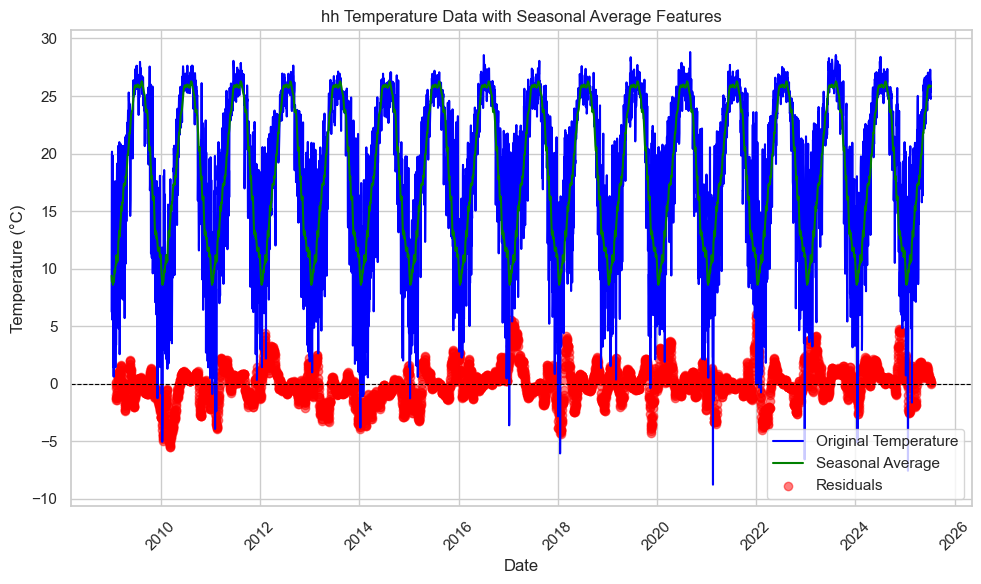

In [ ]:
# Seasonal average features and residuals for temperature data
def seasonal_average_features(df, column, period=365.25, smooth=True, window_size=10):
    """
    Calculate seasonal average features for a given temperature column.
    
    Parameters:
    - df: DataFrame containing the temperature data.
    - column: The name of the temperature column to process.
    - period: The period for seasonal averaging (default is 365.25 days).
    
    Returns:
    - DataFrame with seasonal average features.
    """
    df = df.copy()
    df['day_of_year'] = df['date'].dt.dayofyear
    seasonal_avg = df.groupby('day_of_year')[column].mean().reset_index()
    seasonal_avg.rename(columns={column: f'{column}_seasonal_avg'}, inplace=True)

    # Merge back to the original DataFrame
    df = pd.merge(df, seasonal_avg, on='day_of_year', how='left')

    # Now smooth the merged seasonal average column
    if smooth:
        df[f'{column}_seasonal_avg'] = (
            df[f'{column}_seasonal_avg']
            .rolling(window=window_size, center=True, min_periods=1)
            .mean()
        )
    
    # Calculate residuals
    df[f'{column}_residuals'] = df[column] - df[f'{column}_seasonal_avg']
    print(f"Seasonal average features for {column} calculated.")
    
    return df

# Apply seasonal average features to each temperature column
for wch in ['hh']:# , 'ttf', 'jkm', 'psv']: #df_temp.set_index('date').columns:
    print(f"Calculating seasonal average features for {wch}...")
    temp = seasonal_average_features(df_temp, wch)

    # Plot the original temperature data, seasonal average, and residuals
    plt.figure(figsize=(10, 6))
    plt.plot(temp['date'], temp[wch], label='Original Temperature', color='blue')
    plt.plot(temp['date'], temp[f'{wch}_seasonal_avg'], label='Seasonal Average', color='green')
    plt.scatter(temp['date'], temp[f'{wch}_residuals'].rolling(window=30).mean(), label='Residuals', color='red', alpha=0.5)
    plt.axhline(0, color='black', linestyle='--', linewidth=0.8)
    plt.xlabel('Date')
    plt.ylabel('Temperature (°C)')
    plt.title(f'{wch} Temperature Data with Seasonal Average Features')
    plt.legend()
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

## Plots of the data

In [29]:
# Plot US and NWE natural gas data with temperature, price, and storage
import plotly.express as px
import plotly.graph_objects as go

# US Plot
fig = go.Figure()

# 1. Temperature trace (primary y-axis)
fig.add_trace(go.Scatter(
    x=df_temp['date'],
    y=df_temp['hh'].rolling(window=10).mean(),
    mode='lines+markers',
    name='HH Temperature',
    yaxis='y1'
))

# 2. Henry Hub price trace (secondary y-axis)
fig.add_trace(go.Scatter(
    x=df_mc['date'],
    y=df_mc['hh_price'],
    mode='lines+markers',
    name='Henry Hub Price',
    yaxis='y2'
))

# 3. Storage (y3)
fig.add_trace(go.Scatter(
    x=df_us_storage['date'],
    y=df_us_storage['total lower 48'],
    mode='lines+markers',
    name='US Storage (Bcf)',
    yaxis='y3'
))

# 4. Storage reduction rate (y3)
df_us_storage['total lower 48_diff'] = df_us_storage['total lower 48'].diff()
fig.add_trace(go.Scatter(
    x=df_us_storage['date'],
    y=df_us_storage['total lower 48_diff'],
    mode='lines+markers',
    name='US Storage Reduction Rate',
    yaxis='y3'
))

# Horizontal line at 240 for the reduction rate
fig.add_hline(
    y=240,
    line_dash="dash",
    line_color="black",
    annotation_text="Spike Threshold Rate (approx. 240Bcf/week reduction)",
    annotation_position="top left",
    yref='y3'
)

fig.update_layout(
    title='US Natural Gas: Temperature, Price, and Storage',
    xaxis=dict(title='Date', tickformat='%Y-%m-%d'),
    yaxis=dict(
        title='HH Temperature (°C)',
        side='left'
    ),
    yaxis2=dict(
        title='Henry Hub Price',
        overlaying='y',
        side='right'
    ),
    yaxis3=dict(
        title='Total Lower 48 (Bcf) / Reduction Rate',
        overlaying='y',
        side='right',
        anchor='free',
        position=0.85
    ),
    legend_title_text='Legend',
    hoverlabel=dict(bgcolor="white", font_size=12, font_family="Arial"),
    height=600,
    width=1000
)
fig.show()

#############################################
# NWE Plot
fig_nwe = go.Figure()

# 1. Temperature trace (primary y-axis)
fig_nwe.add_trace(go.Scatter(
    x=df_temp['date'],
    y=df_temp['ttf'],
    mode='lines+markers',
    name='TTF Temperature',
    yaxis='y1'
))

# 2. TTF price trace (secondary y-axis)
fig_nwe.add_trace(go.Scatter(
    x=df_mc['date'],
    y=df_mc['ttf_price'],
    mode='lines+markers',
    name='TTF Price',
    yaxis='y2'
))

# 3. Storage (y3)
fig_nwe.add_trace(go.Scatter(
    x=df_nwe_storage['date'],
    y=df_nwe_storage['storage'],
    mode='lines+markers',
    name='NWE Storage (TWh)',
    yaxis='y3'
))

# 4. Storage reduction rate (y3)
df_nwe_storage['storage_diff'] = df_nwe_storage['storage'].diff()
fig_nwe.add_trace(go.Scatter(
    x=df_nwe_storage['date'],
    y=df_nwe_storage['storage_diff'],
    mode='lines+markers',
    name='NWE Storage Reduction Rate',
    yaxis='y3'
))

fig_nwe.update_layout(
    title='NWE Natural Gas: Temperature, Price, and Storage',
    xaxis=dict(title='Date', tickformat='%Y-%m-%d'),
    yaxis=dict(
        title='TTF Temperature (°C)',
        side='left'
    ),
    yaxis2=dict(
        title='TTF Price',
        overlaying='y',
        side='right'
    ),
    yaxis3=dict(
        title='NWE Storage (TWh) / Reduction Rate',
        overlaying='y',
        side='right',
        anchor='free',
        position=0.85
    ),
    legend_title_text='Legend',
    hoverlabel=dict(bgcolor="white", font_size=12, font_family="Arial"),
    height=600,
    width=1000
)
fig_nwe.show()


In [78]:
# Floating Storage plot: small date range and many zeros, not so useful for analysis
import plotly.express as px

# Plot the storage columns
storage_columns = [col for col in df_mc.columns if col.startswith('floating_storage')]
# Scale y values to be between 0 and 1 for better visualization
df_mc[storage_columns] = df_mc[storage_columns].apply(lambda x: 10 * (x - x.min()) / (x.max() - x.min()))
# Create a line plot with markers for storage trends
fig = px.line(df_mc, x='date', y=storage_columns, title='Floating Storage Trends', markers=False)

# Add the price columns
price_columns = [col for col in df_mc.columns if col.endswith('price')]
for col in price_columns:
    fig.add_scatter(x=df_mc['date'], y=df_mc[col], mode='lines', name=col)

fig.update_layout(
    xaxis_title='Date',
    yaxis_title='Storage',
    legend_title_text='Storage Types',
    xaxis=dict(tickformat='%Y-%m-%d'),
    hoverlabel=dict(bgcolor="white", font_size=12, font_family="Arial"),
    height=800,
    width=1000
)
fig.show()

In [79]:
# Plot the pipe columns
pipe_columns = [col for col in df_mc.columns if col.startswith('pipe')]
price_columns = [col for col in df_mc.columns if col.endswith('price')]
# Create a line plot with markers for pipe trends
fig = px.line(df_mc, x='date', y=pipe_columns, title='Pipe Trends', markers=False)
# Add the price columns on the y2 axis

for col in price_columns:
    fig.add_scatter(x=df_mc['date'], y=df_mc[col], mode='lines', name=col, yaxis='y2')
fig.update_layout(
    xaxis_title='Date',
    yaxis_title='Pipe',
    yaxis2=dict(
        title='Price',
        overlaying='y',
        side='right'
    ),
    legend_title_text='Pipe Types',
    xaxis=dict(tickformat='%Y-%m-%d'),
    hoverlabel=dict(bgcolor="white", font_size=12, font_family="Arial"),
    height=800,
    width=1000
)
fig.show()

In [80]:
# Plot the TTFMc columns with TTF_price
# Summary: The Mc-N prices are similar most of the time but without many spikes. 
# Mc-N price is higher than TTF price when TTF price is lower than average.(?) Traders expected price to be higher (proportionally to N) in the future.
# Also depending the time: e.g., in 6 months is winter, the price is higher than in summer.

ttfmc_columns = [col for col in df_mc.columns if col.endswith('close')]
# Create a line plot with markers for TTFMc trends
fig = px.line(df_mc, x='date', y=ttfmc_columns, title='TTFMc Trends', markers=False)
# Add the TTF price on the y2 axis
fig.add_scatter(x=df_mc['date'], y=df_mc['ttf_price'], mode='lines', name='TTF Price', yaxis='y2')
fig.update_layout(
    xaxis_title='Date',
    yaxis_title='TTFMc',
    yaxis2=dict(
        title='TTF Price',
        overlaying='y',
        side='right'
    ),
    legend_title_text='TTFMc Types',
    xaxis=dict(tickformat='%Y-%m-%d'),
    hoverlabel=dict(bgcolor="white", font_size=12, font_family="Arial"),
    height=800,
    width=1000
)
fig.show()

In [81]:
# Plot the jkm_price and temperature

fig_jkm = go.Figure()
# 1. Temperature trace (primary y-axis)
fig_jkm.add_trace(go.Scatter(
    x=df_temp['date'],
    y=df_temp['jkm'],
    name='JKM Temperature',
    yaxis='y'
))
# 2. JKM price trace (secondary y-axis)

fig_jkm.add_trace(go.Scatter(
    x=df_mc['date'],
    y=df_mc['jkm_price'],
    name='JKM Price',
    yaxis='y2'
))
fig_jkm.update_layout(
    title='JKM Price and Temperature',
    xaxis=dict(title='Date', tickformat='%Y-%m-%d'),
    yaxis=dict(
        title='JKM Price',
        side='left'
    ),
    yaxis2=dict(
        title='Temperature (°C)',
        overlaying='y',
        side='right'
    ),
    legend_title_text='Legend',
    hoverlabel=dict(bgcolor="white", font_size=12, font_family="Arial"),
    height=600,
    width=1000
)
fig_jkm.show()

# Merge the data with more features with the temperature data

In [ ]:
# Merge the df_mc with df_temp on 'date' to have all data in one DataFrame

# Remove the columns starting with 'ttfmc' but not ending with 'close' from df_mc
df_mc.drop(columns=df_mc.columns[df_mc.columns.str.startswith('ttfmc') & ~df_mc.columns.str.endswith('close')], inplace=True)

# Add subfix 'temperature' to the temperature columns
df_temp.columns = [col + '_temperature' if col != 'date' else col for col in df_temp.columns]

# Convert 'date' columns to date only (ignore time) before merging
df_mc['date'] = pd.to_datetime(df_mc['date']).dt.date
df_temp['date'] = pd.to_datetime(df_temp['date']).dt.date
df_us_storage_total['date'] = pd.to_datetime(df_us_storage_total['date']).dt.date
df_nwe_storage['date'] = pd.to_datetime(df_nwe_storage['date']).dt.date

/var/folders/qt/8nh0yrjj4q5dvgzzdm8s9j_40000gn/T/ipykernel_41382/613320212.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
# Set nan for the rows of jkm_price and jkm_volume for dates before 2014-07-29 in df_mc
mask_jkm = df_mc['date'] < pd.to_datetime('2014-07-29').date()
df_mc.loc[mask_jkm, ['jkm_price', 'jkm_volume']] = np.nan

# Merge sequentially
df_merged = pd.merge(df_mc, df_temp, on='date', how='outer')
df_merged = pd.merge(df_merged, df_nwe_storage, on='date', how='outer')
df_merged = pd.merge(df_merged, df_us_storage_total, on='date', how='outer')

# rename columns
df_merged.rename(columns={
    'total lower 48': 'us_storage',
    'storage': 'nwe_storage'
}, inplace=True)

# Convert 'date' to datetime for easier handling
df_merged['date'] = pd.to_datetime(df_merged['date'])

# Add 'day_of_week' number for grouping
df_merged['day_of_week'] = df_merged['date'].dt.dayofweek

# Remove all weekend rows (Saturday=5, Sunday=6)
df_merged = df_merged[df_merged['day_of_week'] < 5].reset_index(drop=True)

# Drop the 'day_of_week' column as it is not needed anymore
df_merged.drop(columns=['day_of_week'], inplace=True)

# Interpolate: weekly to daily for the us_storage
df_merged.set_index('date', inplace=True)
df_merged['us_storage'] = df_merged['us_storage'].interpolate(method='time')
df_merged.reset_index(inplace=True)

# Export the merged data to a new CSV file
output_merged = 'price_vol_temp_inven_mc_merged_cleaned_data.csv'
df_merged.to_csv(output_merged, index=False)

# Display the merged DataFrame
df_merged

In [ ]:
# Plot the merged data
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Plot the price, volume, temperature, inventory, floating storage, pipe, and TTFMc data in differnet subplots
price_columns = [col for col in df_merged.columns if col.endswith('_price')]
volume_columns = [col for col in df_merged.columns if col.endswith('_volume')]
temperature_columns = [col for col in df_merged.columns if col.endswith('_temperature')]
inventory_columns = [col for col in df_merged.columns if col.startswith('invento')]
floating_storage_columns = [col for col in df_merged.columns if col.startswith('floating_storage')]
pipe_columns = [col for col in df_merged.columns if col.startswith('pipe')]
ttfmc_columns = [col for col in df_merged.columns if col.endswith('close')]
storage_columns = ['nwe_storage', 'us_storage']

# Plots for each type of data: price columns, volume, temperature, inventory, floating storage, pipe, TTFMc
type_names = [
    'Price',
    'Volume',
    'Temperature',
    'Inventory',
    'Floating Storage',
    'Pipe',
    'TTFMc',
    'Storage'
]

plot_list = [
    price_columns,
    volume_columns,
    temperature_columns,
    inventory_columns,
    floating_storage_columns,
    pipe_columns,
    ttfmc_columns,
    storage_columns
]

# fig = make_subplots(rows=4, cols=2, subplot_titles=tuple(type_names))
# for i, cols in enumerate(plot_list):
#     # For each column in the current type, add a trace to the subplot
#     row_num = (i // 2) + 1
#     col_num = (i % 2) + 1

#     for j, col in enumerate(cols):
#         fig.add_trace(
#             go.Scatter(x=df_merged['date'], y=df_merged[col], mode='lines+markers', name=col),
#             row=row_num, col=col_num
#         )

# # Update layout for better readability
# fig.update_layout(title_text="Merged Data Subplots", height=1000)
# fig.show()


# Plot in different figures instead of subplots
for i, cols in enumerate(plot_list):
    fig = px.line(df_merged, x='date', y=cols, title=f'{type_names[i]} Trends', markers=False)
    
    # Add a vertical line for each changepoint
    for cp in changepoints:
        fig.add_vline(
            x=cp,
            line_dash="dash",
            line_color="black",
            # annotation_text=f"Changepoint: {cp}",
            # annotation_position="top left"
        )
    
    # Update the layout for better readability
    fig.update_layout(
        xaxis_title='Date',
        yaxis_title=type_names[i],
        legend_title_text='Types',
        xaxis=dict(tickformat='%Y-%m-%d'),
        hoverlabel=dict(bgcolor="white", font_size=12, font_family="Arial"),
        height=600,
        width=1000
    )
    
    fig.show()


In [ ]:
# Check all the data time ranges and summarize them, storing in a dictionary
data_time_ranges = {}
for col in df_merged.columns:
    if col != 'date':
        time_range = df_merged[col].dropna().index
        if not time_range.empty:
            start_date = df_merged['date'].iloc[time_range[0]]
            end_date = df_merged['date'].iloc[time_range[-1]]
            data_time_ranges[col] = (start_date, end_date)
        else:
            data_time_ranges[col] = (None, None)
# Print the time ranges for each column
print("\nData Time Ranges:")
for col, (start_date, end_date) in data_time_ranges.items():
    if start_date and end_date:
        start_date = start_date.strftime('%Y-%m-%d')
        end_date = end_date.strftime('%Y-%m-%d')
        if start_date == end_date:
            print(f"{col}: {start_date} (single date)")
        else:
            print(f"{col}: {start_date} to {end_date}")


Data Time Ranges:
psv_price: 2011-07-07 to 2025-06-20
brent_price: 2009-01-02 to 2025-07-07
ttf_futures_price: 2017-10-23 to 2025-07-08
pvb_price: 2020-05-22 to 2025-05-22
jkm_price: 2014-07-29 to 2025-07-03
nbp_price: 2009-08-03 to 2025-06-20
cboe_price: 2009-01-02 to 2025-07-07
coal_price: 2009-01-02 to 2025-07-04
hh_price: 2009-01-02 to 2025-06-30
ttf_price: 2009-01-01 to 2025-06-20
brent_volume: 2009-01-02 to 2025-07-07
ttf_futures_volume: 2018-03-01 to 2025-07-08
coal_volume: 2009-01-08 to 2025-07-04
temp_global: 2009-01-01 to 2025-07-01
temp_southern_hemisphere: 2009-01-01 to 2025-07-01
temp_northern_hemisphere: 2009-01-01 to 2025-07-01
netimports_total: 2009-01-01 to 2025-07-04
inventories_global: 2017-01-02 to 2025-07-04
pipe_norway: 2018-08-01 to 2025-03-17
pipe_algeria: 2018-08-01 to 2025-03-17
pipe_russia: 2018-08-01 to 2025-03-17
pipe_azerbaijan: 2018-08-01 to 2025-03-17
pipe_libya: 2018-08-01 to 2025-03-17
pipe_uk net flows: 2018-08-01 to 2025-03-17
pipe_lng: 2018-08-01 t

# Load the city temperature data

In [ ]:
# Load the CSV file
# t_file = 'temperature_data_17_cities.csv'
# df_t = pd.read_csv(t_file, parse_dates=['Date'])
# # Preview data
# df_t

# Load the CSV file
t_file = 'temperature_data_6_regions.csv'
df_t = pd.read_csv(t_file, parse_dates=['date'])

# Lowercase the column names (already done in Merger_20250709.ipynb)
# df_t.columns = df_t.columns.str.lower()

# Keep only the date part (remove time)
df_t['date'] = df_t['date'].dt.date

# Preview data
df_t